<a href="https://colab.research.google.com/github/m1chae11u/multiclass_CNN_furniture_classifier/blob/main/multiclass_CNN_furniture_classifier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
import torchvision
import torchvision.transforms as transforms
import os
import shutil
import numpy as np

# import zipfile
# zip_path = '/content/ezyzip-furniture.zip'
# with zipfile.ZipFile(zip_path, 'r') as zip_ref:
#     zip_ref.extractall('/content')

Load Data

In [ ]:
val_data = '/content/valid'
train_data = '/content/train'

# # Create the val directory if it doesn't exist
# if not os.path.exists(val_data):
#     os.mkdir(val_data)

# # Function to move a subset of images
# def move_images(src_folder, dest_folder, ratio=0.2):
#     # Ensure the destination folder exists
#     if not os.path.exists(dest_folder):
#         os.mkdir(dest_folder)

#     # List all files in the source folder
#     files = [file for file in os.listdir(src_folder) if os.path.isfile(os.path.join(src_folder, file))]

#     # Calculate how many files to move
#     n_files_to_move = int(len(files) * ratio)

#     # Randomly select files to move
#     files_to_move = np.random.choice(files, n_files_to_move, replace=False)

#     # Move the selected files
#     for file in files_to_move:
#         shutil.move(os.path.join(src_folder, file), os.path.join(dest_folder, file))

# # Iterate over each category in the training data
# for category in os.listdir(train_data):
#     category_train_folder = os.path.join(train_data, category)
#     category_val_folder = os.path.join(val_data, category)

#     if os.path.isdir(category_train_folder):
#         move_images(category_train_folder, category_val_folder, ratio=0.2)

In [ ]:
def count_files(directory):
    total_count = 0
    for root, dirs, files in os.walk(directory):
        total_count += len([file for file in files if os.path.isfile(os.path.join(root, file))])
    return total_count

print(f"Total number of files in train folder: {count_files(train_data)}")
print(f"Total number of files in val folder: {count_files(val_data)}")
print(f"Total number of files in test folder: {count_files(test_data)}")

Total number of files in train folder: 4154
Total number of files in val folder: 2333
Total number of files in test folder: 2164


In [ ]:
classes = {0: 'bed', 1:'chair', 2:'sofa', 3:'swivelchair', 4:'table'}

In [ ]:
from torchvision import datasets
from torch.utils.data import DataLoader

# Define transformations for the training data
train_transforms = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to 224x224 pixels
    transforms.RandomHorizontalFlip(),  # Randomly flip images horizontally
    transforms.ToTensor(),  # Convert images to PyTorch tensors
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize pixel values
])

# Define transformations for the validation data
val_transforms = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to 224x224 pixels
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

#apply the transformations to the train and valid sets
train_dataset = datasets.ImageFolder(train_data, transform=train_transforms)
val_dataset = datasets.ImageFolder(val_data, transform=val_transforms)

batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

In [ ]:
train_iterator = iter(train_loader)
train_inputs, train_labels = next(train_iterator)

val_iterator = iter(val_loader)
val_inputs, val_labels = next(val_iterator)

In [ ]:
train_labels

tensor([1, 1, 4, 2, 0, 3, 4, 4, 4, 3, 2, 3, 0, 3, 2, 1, 1, 2, 1, 3, 0, 4, 1, 3,
        1, 2, 0, 4, 4, 2, 3, 1])

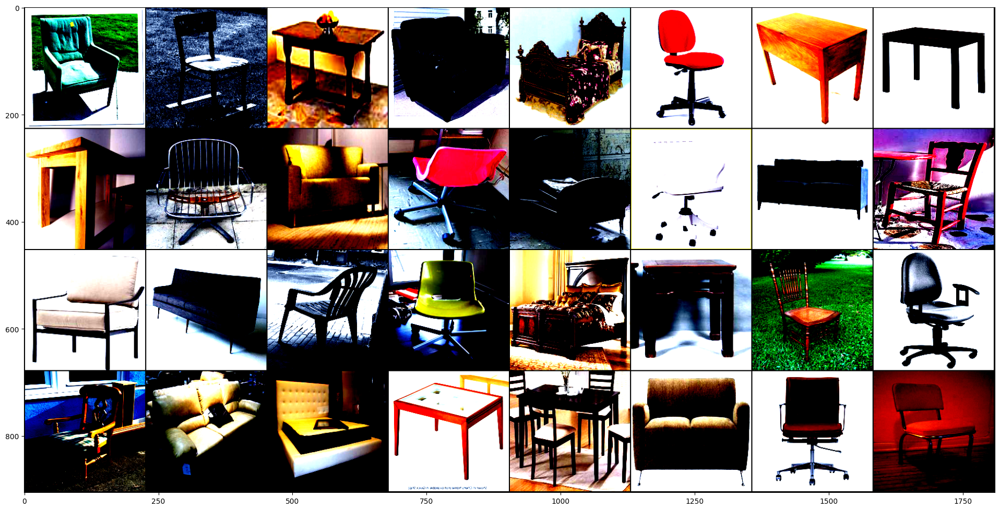

In [ ]:
import matplotlib.pyplot as plt

def imshow(img):
  np_img = img.numpy()
  plt.imshow(np.transpose(np_img, (1, 2, 0)))
  plt.show()

plt.figure(figsize=(24, 24))
imshow(torchvision.utils.make_grid(train_inputs))

Model Architecture

In [ ]:
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

class CNNImageClassifier1(nn.Module):

  def __init__(self):
        super(CNNImageClassifier1, self).__init__()
        # Convolutional layer (sees 224x224x3 image tensor)
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=16, kernel_size=3, stride=1, padding=1)
        # Convolutional layer (sees 112x112x16 tensor)
        self.conv2 = nn.Conv2d(16, 32, 3, 1, 1)
        # Convolutional layer (sees 56x56x32 tensor)
        self.conv3 = nn.Conv2d(32, 64, 3, 1, 1)
        # Max pooling
        self.pool = nn.MaxPool2d(2, 2)
        # Linear layer (64 * 28 * 28 -> 500)
        self.fc1 = nn.Linear(64 * 28 * 28, 500)
        # Linear layer (500 -> 5)
        self.fc2 = nn.Linear(500, 5)
        # Dropout layer (p=0.5)
        self.dropout = nn.Dropout(0.5)

  def forward(self, x):
        # Add sequence of convolutional and max pooling layers
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))
        # Flatten image input
        x = x.view(-1, 64 * 28 * 28)
        # Add dropout layer
        x = self.dropout(x)
        # Add first dense layer
        x = F.relu(self.fc1(x))
        # Add dropout layer
        x = self.dropout(x)
        # Add second dense layer
        x = self.fc2(x)
        return x

model = CNNImageClassifier1()
loss_function = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

Model Training

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

def train_model(model, train_loader, val_loader, loss_function, optimizer, num_epochs=10):
    # Move model to the device (GPU or CPU)
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    # Lists to store metrics
    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):
        model.train()  # Set the model to training mode
        running_loss = 0.0

        # Training loop
        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)

            # Zero the parameter gradients
            optimizer.zero_grad()

            # Forward pass
            outputs = model(inputs)
            loss = loss_function(outputs, labels)

            # Backward pass and optimize
            loss.backward()
            optimizer.step()

            running_loss += loss.item()

        avg_train_loss = running_loss / len(train_loader)
        train_losses.append(avg_train_loss)

        # Validation loop
        model.eval()
        running_val_loss = 0.0
        all_predictions = []
        all_labels = []
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)

                outputs = model(inputs)
                loss = loss_function(outputs, labels)

                running_val_loss += loss.item()

                # Get predictions and actual labels
                _, predicted = torch.max(outputs.data, 1)
                all_predictions.extend(predicted.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())

        avg_val_loss = running_val_loss / len(val_loader)
        val_losses.append(avg_val_loss)

        # Calculate metrics
        accuracy = accuracy_score(all_labels, all_predictions)
        precision = precision_score(all_labels, all_predictions, average='weighted')
        recall = recall_score(all_labels, all_predictions, average='weighted')
        f1 = f1_score(all_labels, all_predictions, average='weighted')

        print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.4f}, Validation Loss: {avg_val_loss:.4f}, Accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")

    print('Finished Training')
    return model, train_losses, val_losses

# Train the model
num_epochs = 30
trained_model, train_losses, val_losses = train_model(model, train_loader, val_loader, loss_function, optimizer, num_epochs=num_epochs)

Epoch [1/30], Train Loss: 1.4620, Validation Loss: 1.2276, Accuracy: 0.5360, Precision: 0.6380, Recall: 0.5360, F1 Score: 0.5166
Epoch [2/30], Train Loss: 1.0549, Validation Loss: 0.9460, Accuracy: 0.6428, Precision: 0.6566, Recall: 0.6428, F1 Score: 0.6342
Epoch [3/30], Train Loss: 0.8674, Validation Loss: 0.7871, Accuracy: 0.7127, Precision: 0.7232, Recall: 0.7127, F1 Score: 0.7134
Epoch [4/30], Train Loss: 0.7856, Validation Loss: 0.7862, Accuracy: 0.7084, Precision: 0.7271, Recall: 0.7084, F1 Score: 0.7064
Epoch [5/30], Train Loss: 0.7064, Validation Loss: 0.7021, Accuracy: 0.7517, Precision: 0.7615, Recall: 0.7517, F1 Score: 0.7512
Epoch [6/30], Train Loss: 0.6347, Validation Loss: 0.6593, Accuracy: 0.7650, Precision: 0.7762, Recall: 0.7650, F1 Score: 0.7655
Epoch [7/30], Train Loss: 0.5791, Validation Loss: 0.6062, Accuracy: 0.7877, Precision: 0.7899, Recall: 0.7877, F1 Score: 0.7870
Epoch [8/30], Train Loss: 0.5415, Validation Loss: 0.5773, Accuracy: 0.8053, Precision: 0.8099, R

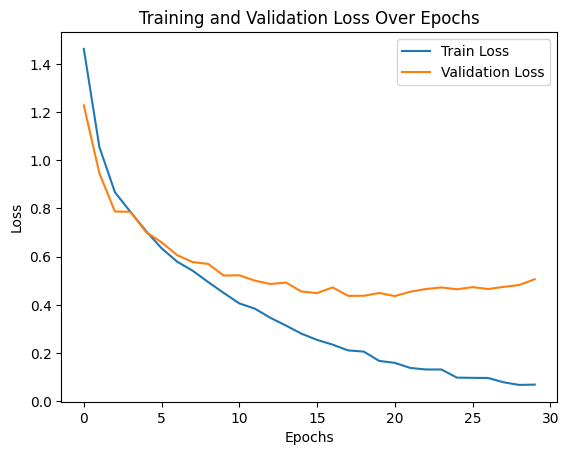

In [ ]:
# Plotting
plt.plot(range(num_epochs), train_losses, label='Train Loss')
plt.plot(range(num_epochs), val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation Loss Over Epochs')
plt.legend()
plt.show()

In [ ]:
#can't use this section because test data isn't split into the correct categories...
#instead i will plot a bunch of images from the test set
# test_transforms = val_transforms
# test_dataset = datasets.ImageFolder(test_data, transform=test_transforms)
# test_batch_size = 8
# test_loader = DataLoader(test_dataset, batch_size=test_batch_size, shuffle=False, num_workers=2)

# def test_model(model, test_loader):
#     # Move model to the device (GPU or CPU)
#     device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#     model.to(device)

#     # Set model to evaluation mode
#     model.eval()

#     correct = 0
#     total = 0
#     with torch.no_grad():
#         for inputs, labels in test_loader:
#             inputs, labels = inputs.to(device), labels.to(device)

#             # Forward pass
#             outputs = model(inputs)
#             _, predicted = torch.max(outputs.data, 1)
#             total += labels.size(0)
#             correct += (predicted == labels).sum().item()

#     accuracy = 100 * correct / total
#     print(f'Accuracy of the model on the test data: {accuracy:.2f}%')

#     return accuracy

# test_accuracy = test_model(trained_model, test_loader)

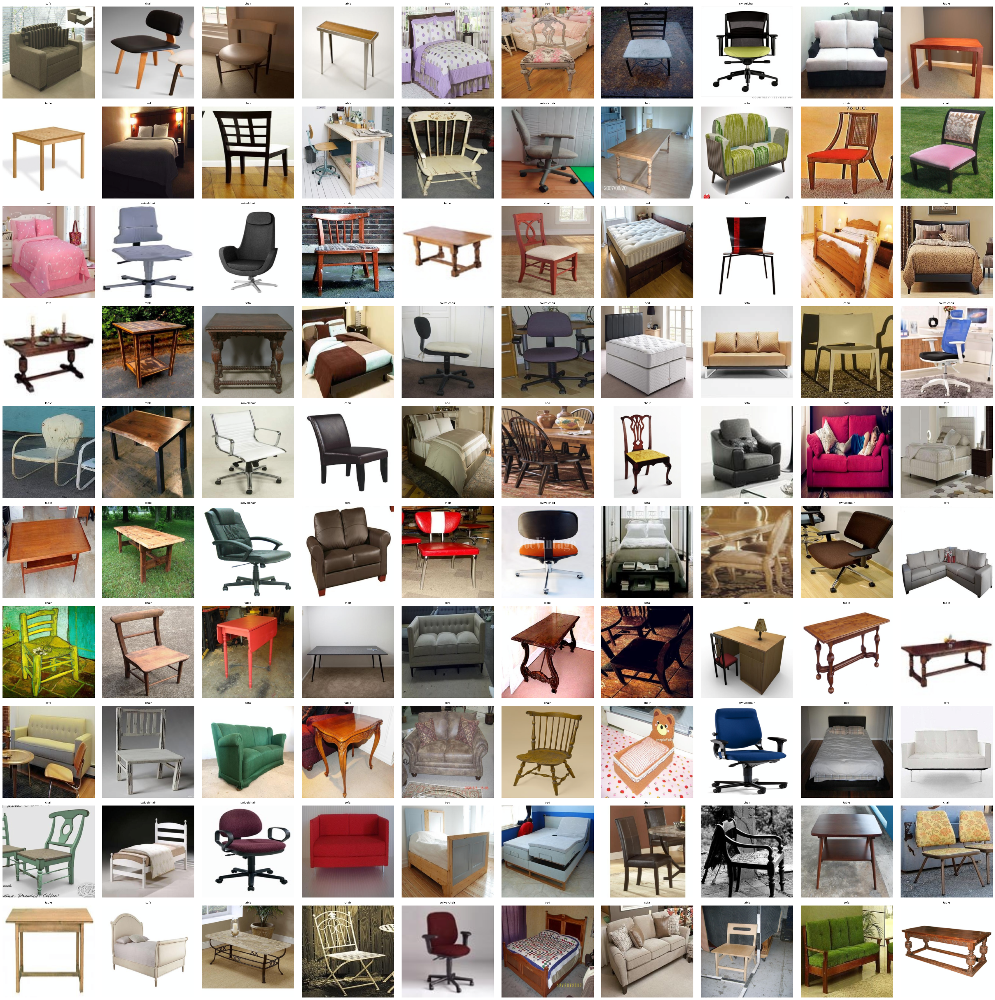

In [ ]:
from torch.utils.data import Dataset
from PIL import Image
class CustomImageDataset(Dataset):
    def __init__(self, main_dir, transform):
        self.main_dir = main_dir
        self.transform = transform
        self.all_imgs = os.listdir(main_dir)

    def __len__(self):
        return len(self.all_imgs)

    def __getitem__(self, idx):
        img_loc = os.path.join(self.main_dir, self.all_imgs[idx])
        image = Image.open(img_loc).convert("RGB")
        tensor_image = self.transform(image)
        return tensor_image

# Define transformations for the test data
test_transforms = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to 224x224 pixels
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create custom dataset
test_data = '/content/test'
test_dataset = CustomImageDataset(main_dir=test_data, transform=test_transforms)

# Create DataLoader for test dataset
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False)

def get_predictions(model, test_loader):
    model.eval()  # Set the model to evaluation mode
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    predictions = []
    images = []
    with torch.no_grad():
        for inputs in test_loader:
            inputs = inputs.to(device)

            # Forward pass
            outputs = model(inputs)
            _, predicted = torch.max(outputs, 1)

            predictions.extend(predicted.cpu().numpy())
            images.extend(inputs.cpu())

    return images, predictions

# Get predictions
images, predictions = get_predictions(trained_model, test_loader)

def plot_images(images, predictions, num_images=10, columns=5, font_size=10):
    # Mapping from numbers to category names
    categories = {0: 'bed', 1: 'chair', 2: 'sofa', 3: 'swivelchair', 4: 'table'}

    rows = num_images // columns + (num_images % columns > 0)
    figure_size = 4  # Adjust this value to change the size of each image in the plot
    plt.figure(figsize=(figure_size * columns, figure_size * rows))

    for i in range(min(num_images, len(images))):
        plt.subplot(rows, columns, i + 1)
        img = images[i].numpy().transpose((1, 2, 0))
        mean = [0.485, 0.456, 0.406]
        std = [0.229, 0.224, 0.225]
        img = std * img + mean
        img = np.clip(img, 0, 1)
        plt.imshow(img)
        category = categories.get(predictions[i], "Unknown")  # Get category name from predictions
        plt.title(f'{category}', fontsize=font_size)
        plt.axis('off')

    plt.tight_layout()  # Adjusts subplot params so that the subplot(s) fits in the figure area
    plt.show()
# Plot more test images along with the predicted labels
plot_images(images, predictions, num_images=100, columns=10, font_size=8)

In [28]:
print("accuracy: " + str(85/100))

accuracy: 0.85


In [29]:
torch.save(trained_model.state_dict(), 'furniture-model.pth')